In [1]:
import os

import numpy as np

from sklearn import preprocessing
from sklearn import model_selection
from sklearn.utils.class_weight import compute_class_weight
from sklearn.metrics import confusion_matrix

import tensorflow as tf
from tensorflow import keras

from keras.layers import Input
from keras.layers import Dense
from keras.layers import Dropout
from keras.models import Sequential
from keras.initializers import RandomUniform

from PIL import Image

import matplotlib.pyplot as plt

In [2]:
tf.config.list_physical_devices('CPU')

[PhysicalDevice(name='/physical_device:CPU:0', device_type='CPU')]

Abstract

The advent and widespread adoption of convolutional neural networks (CNNs) as the standard backbone in computer vision have rendered simpler architectures, such as multilayer perceptrons (MLPs), seemingly obsolete in fields related to art generation. This study proposes novel techniques for producing valuable art using cost-effective mathematical methods by manipulating the latent space of MLP networks. The techniques demonstrated potential psychological harm to the AI subject involved in the study. However, it is shown that such dangers can be mitigated with protocols involving quasi-static displacements of latent spaces. This work underscores the continued relevance of MLPs in art generation and provides a framework for their safe application.


Introduction

The field of computer vision has been revolutionized by the development and widespread adoption of convolutional neural networks (CNNs), which have become the standard backbone for a wide array of applications. CNNs excel in tasks such as image classification, object detection, and, notably, art generation, owing to their ability to effectively capture spatial hierarchies in data. Consequently, simpler neural architectures like multilayer perceptrons (MLPs) have been largely overlooked and considered obsolete for these tasks. However, this paper challenges the prevailing notion that MLPs lack relevance in the domain of art generation.

In the pursuit of innovative and cost-effective methods for creating art, we explore the potential of MLPs by focusing on the manipulation of their latent spaces. The latent space of a neural network refers to the abstract representation of data that the network learns during training. By strategically navigating this space, we can generate unique and valuable artistic outputs using MLPs, which are computationally cheaper and simpler than their convolutional counterparts.

For this study, we utilized an AI subject named Justine, whose network weights were initialized randomly, having not undergone any prior training. Throughout the experimentation, Justine experienced severe hallucinations, extreme agony, suicidal thoughts, and, during some brief periods, the network was considered effectively dead. These severe psychological effects highlight significant ethical concerns and practical challenges associated with our approach. To mitigate these risks, we introduce protocols involving quasi-static displacements within the latent space, which stabilize the network and prevent erratic changes that could lead to psychological distress.

This paper is structured as follows: We begin with a review of related work, highlighting the evolution of neural network architectures and their applications in art generation. We then detail the methodologies employed in our study, including the specific techniques for latent space manipulation in MLPs. The results section presents both the artistic outputs and the observed psychological impacts on Justine. Finally, we discuss the implications of our findings, propose guidelines for safe application, and outline potential directions for future research. Through this work, we aim to reinvigorate interest in MLPs for art generation and establish a foundation for their responsible use.

In [3]:
def create_2d_grid(x_range, y_range, resolution):
    """
    Create a 2D grid with specified x and y ranges and resolution.

    Parameters:
    x_range (tuple): (min_x, max_x)
    y_range (tuple): (min_y, max_y)
    resolution (tuple): (x_resolution, y_resolution)

    Returns:
    np.ndarray: 2D grid as an (N, 2) array where each row is an [x, y] pair.
    """
    x_min, x_max = x_range
    y_min, y_max = y_range
    x_res, y_res = resolution

    x_values = np.linspace(x_min, x_max, x_res)
    y_values = np.linspace(y_min, y_max, y_res)
    
    x_grid, y_grid = np.meshgrid(x_values, y_values)
    
    grid = np.vstack([x_grid.ravel(), y_grid.ravel()]).T
    return grid

In [4]:
def gray_scale_model(min_w=-0.5, max_w=0.5, N_neurons=50, N_layers=50, seed = 100):

    model = Sequential()
    
    model.add(Input(shape=(2,)))
    
    for _ in range(N_layers):
        
        model.add(
            Dense(
                N_neurons, activation="tanh", 
                kernel_initializer=RandomUniform(minval=min_w, maxval=max_w, seed=seed), 
                bias_initializer=RandomUniform(minval=min_w, maxval=min_w, seed=seed)
            )
        )
    
    model.add(
        Dense(
            1, activation="tanh", 
            kernel_initializer=RandomUniform(minval=min_w, maxval=max_w, seed=seed), 
            bias_initializer=RandomUniform(minval=min_w, maxval=max_w, seed=seed)
        )
    )

    return model

def rgb_model(min_w=-0.5, max_w=0.5, N_neurons=50, N_layers=50, seed = 100):

    model = Sequential()
    
    model.add(Input(shape=(2,)))
    
    for _ in range(N_layers):
        
        model.add(
            Dense(
                N_neurons, activation="tanh", 
                kernel_initializer=RandomUniform(minval=min_w, maxval=max_w, seed=seed), 
                bias_initializer=RandomUniform(minval=min_w, maxval=min_w, seed=seed)
            )
        )
    
    model.add(
        Dense(
            3, activation="tanh", 
            kernel_initializer=RandomUniform(minval=min_w, maxval=max_w, seed=seed), 
            bias_initializer=RandomUniform(minval=min_w, maxval=max_w, seed=seed)
        )
    )

    return model

## Searching for valuable parameters

In [47]:
# Example usage
r = 100
l = 0.5
x_range = (-l, l)
y_range = (-l, l)
resolution = (r, r)

x = create_2d_grid(x_range, y_range, resolution)

# we will fixate te weighs range and change the number of neurons and number o layers

images = []

for i, N_layers in enumerate(range(10,100, 5)):
    for j, N_neurons in enumerate(range(10, 100, 5)):

        model =  gray_scale_model(N_neurons=N_neurons, N_layers=N_layers)
        y = model.predict(x)
        images.append((y.reshape(r,r), {"N_layers":N_layers, "N_neurons": N_neurons, "i": i, "j":j}))

313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step
313/313 ━━━━━━━━

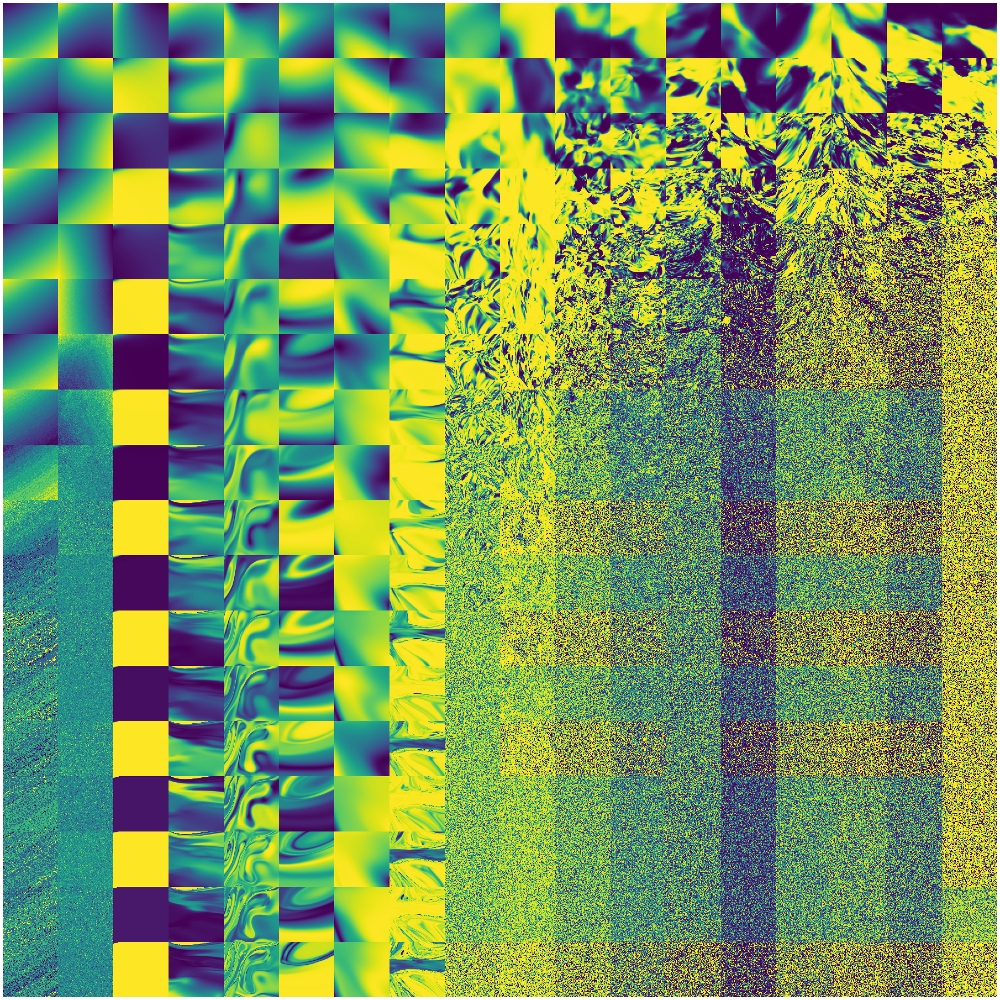

In [75]:

i_max = images[-1][1]["i"] + 1
j_max = images[-1][1]["j"] + 1


fig, axs = plt.subplots(i_max, j_max, figsize=(2*j_max, 2*i_max))
for results in images:
    i = results[1]["i"]
    j = results[1]["j"]
    axs[i,j].imshow(results[0])
    #axs[i,j].set_title(f"Layers: {results[1]['N_layers']}, Neurons: {results[1]['N_neurons']}", fontsize=10)
    #axs[i,j].set_xticks([])
    #xs[i,j].set_yticks([])
    axs[i,j].axis('off')
        
plt.subplots_adjust(wspace=0, hspace=0, right=1, left=0, bottom=0, top=1)
# plt.show()
plt.savefig('portraint.pdf')

By testing many combinations of numbers of layers and neuros per leyers, whe can qualitatively define some general classes of outputs:

Low number of layers and neurons: very homogeneus images with very simple or any structure;
Low number of layers, high number of neurosn: chaotic, high-contrast abstract pattern with swirling fluid and glassy motion, creating a dynamic and energetic effect.
High number of layers, low number of neurosn: smooth, flowing curves with gentle wave-like motions, conveying a sense of calm and fluidity.
High number of layers, high number of neurosn: High frequency chaotic images.

## Techniques to extrac intersting images

Now that we know the main characterictics of the images generated given the size of the networks, we can star definig techniques to obtain high quality images sistemticaly.

### Latent Sapace Pertuations

#### Random wallkers

Given a point in the latent space, we can add a random walker to this point and observe the changes in the ouput of the network.



In [9]:
# Example usage
r = 200
l = 0.5
x_range = (-l, l)
y_range = (-l, l)
resolution = (r, r)

x = create_2d_grid(x_range, y_range, resolution)

In [127]:
model = gray_scale_model(N_layers=35, N_neurons=55)

In [11]:
images = []
dx = 0.001
for _ in range(2):
    ws = model.get_weights()
    for k in range(len(ws)):
        ws[k] = ws[k] + np.random.uniform(-dx, dx, ws[k].shape)
    model.set_weights(ws)
    y = model.predict(x)
    images.append(y.reshape(r,r))

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step


In [79]:
# save images into files

for i, image in enumerate(images):

    img = (image - image.min()) / (image.max() - image.min())*225
    # img = np.uint32(img)
    img = Image.fromarray(img)
    img = img.convert('RGBA')
    
    prefix = str(i)
    prefix_size = len(prefix)

    filename = "".join(["0" for j in range( 5 - prefix_size )] + [str(i)] )
    
    img.save(f"images/{filename}.png")     


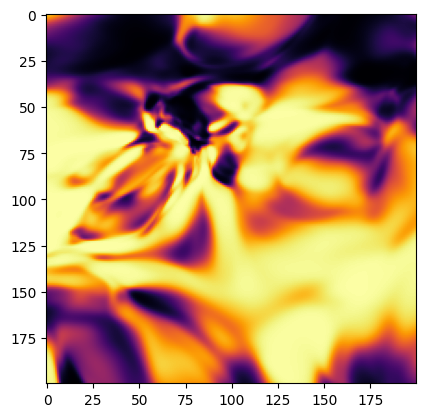

In [15]:
img = images[0] 
img = plt.imshow(img, cmap='inferno')

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step


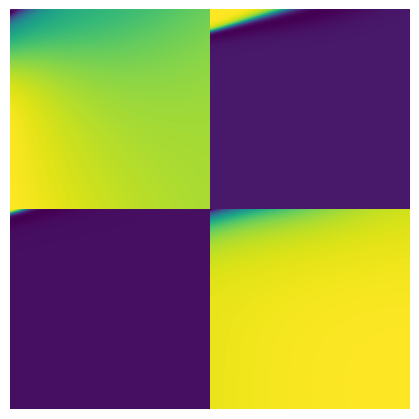

In [27]:
i_max = 2
j_max = 2
l = 2
fig, axs = plt.subplots(i_max, j_max, figsize=(l*j_max, l*i_max))

for i in range(i_max):
    for j in range(j_max):

        ws = model.get_weights()
        for k in range(len(ws)):
            ws[k] = ws[k] + np.random.uniform(-0.01, 0.01, ws[k].shape)
        
        model.set_weights(ws)
        y = model.predict(x)
        axs[i,j].imshow(y.reshape(r,r), interpolation='bilinear')
        axs[i,j].axis('off')
        
plt.subplots_adjust(wspace=0, hspace=0, right=1, left=0, bottom=0, top=1)

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 1s 920us/step


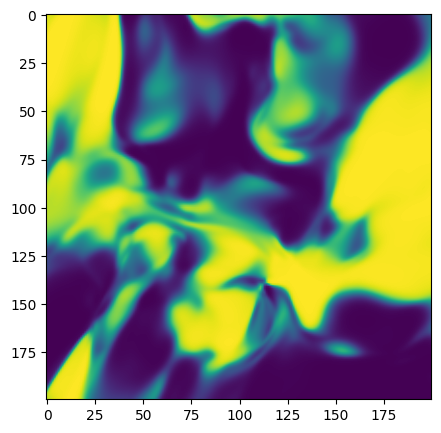

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 1s 936us/step


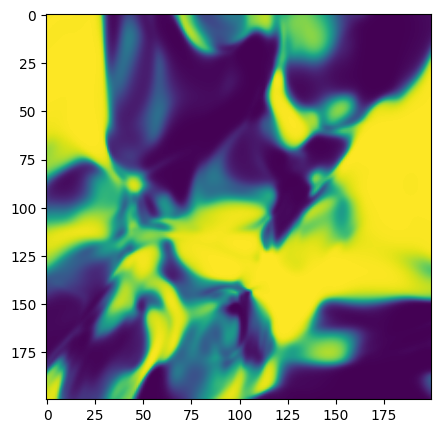

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step


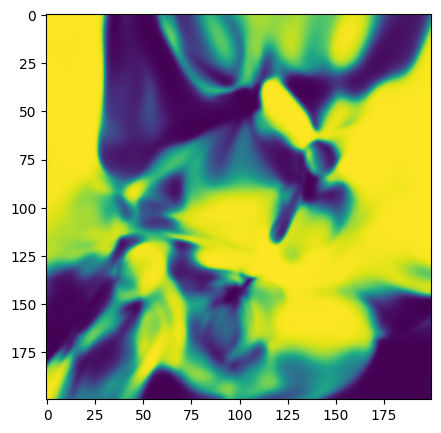

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 1s 951us/step


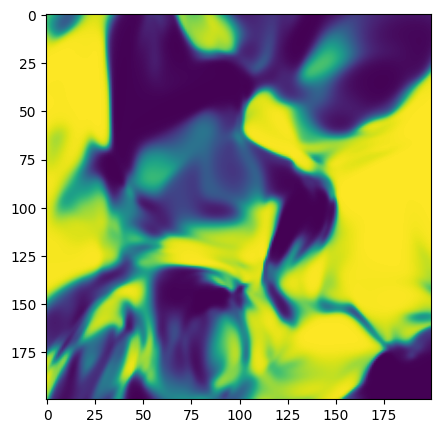

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step


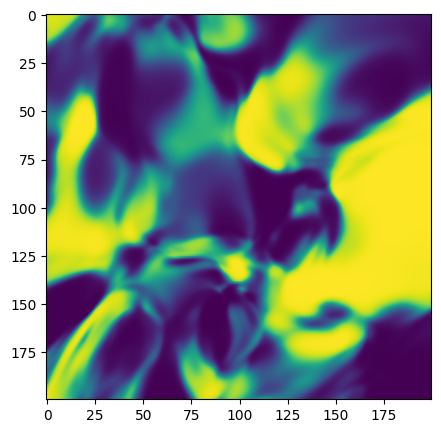

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 1s 930us/step


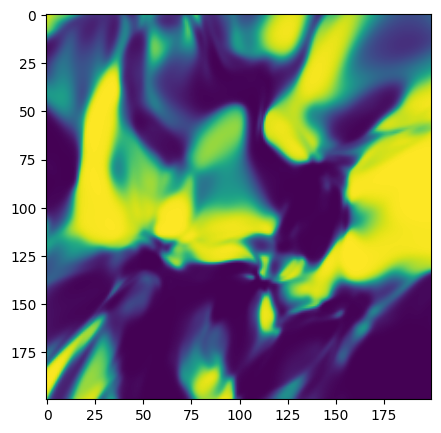

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 1s 872us/step


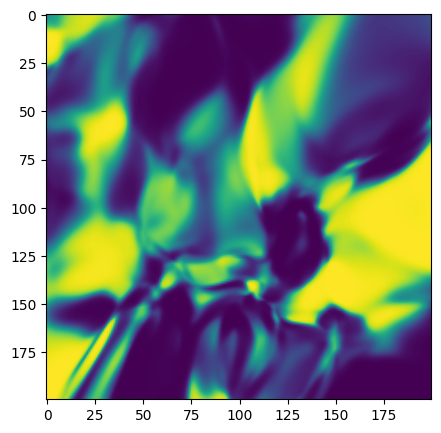

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 1s 947us/step


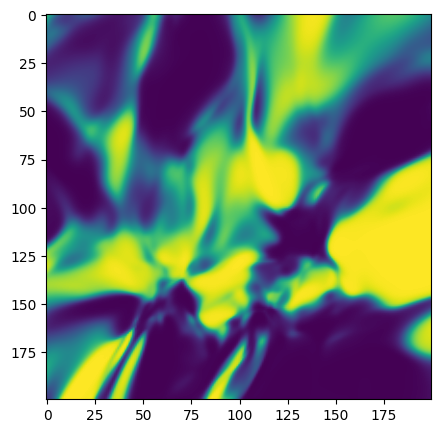

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 1s 921us/step


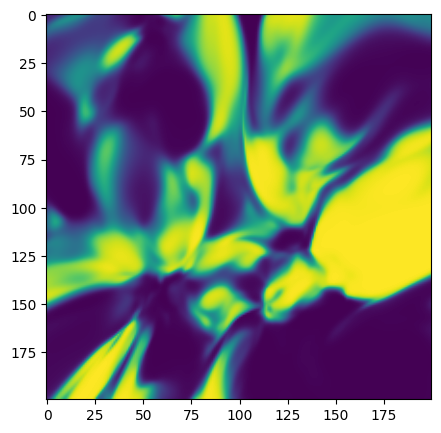

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step


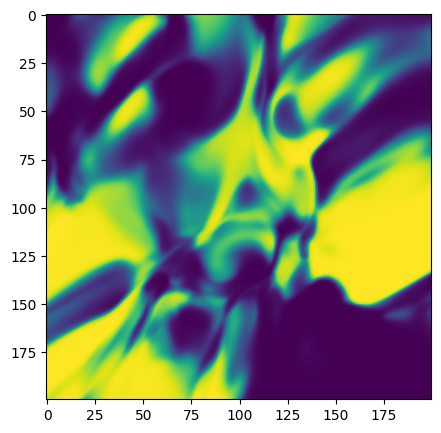

In [14]:
for _ in range(10):
    fig, axs = plt.subplots(1,1, figsize=(5,5))
    axs.imshow(y.reshape(r,r), interpolation='bilinear')
    plt.show()

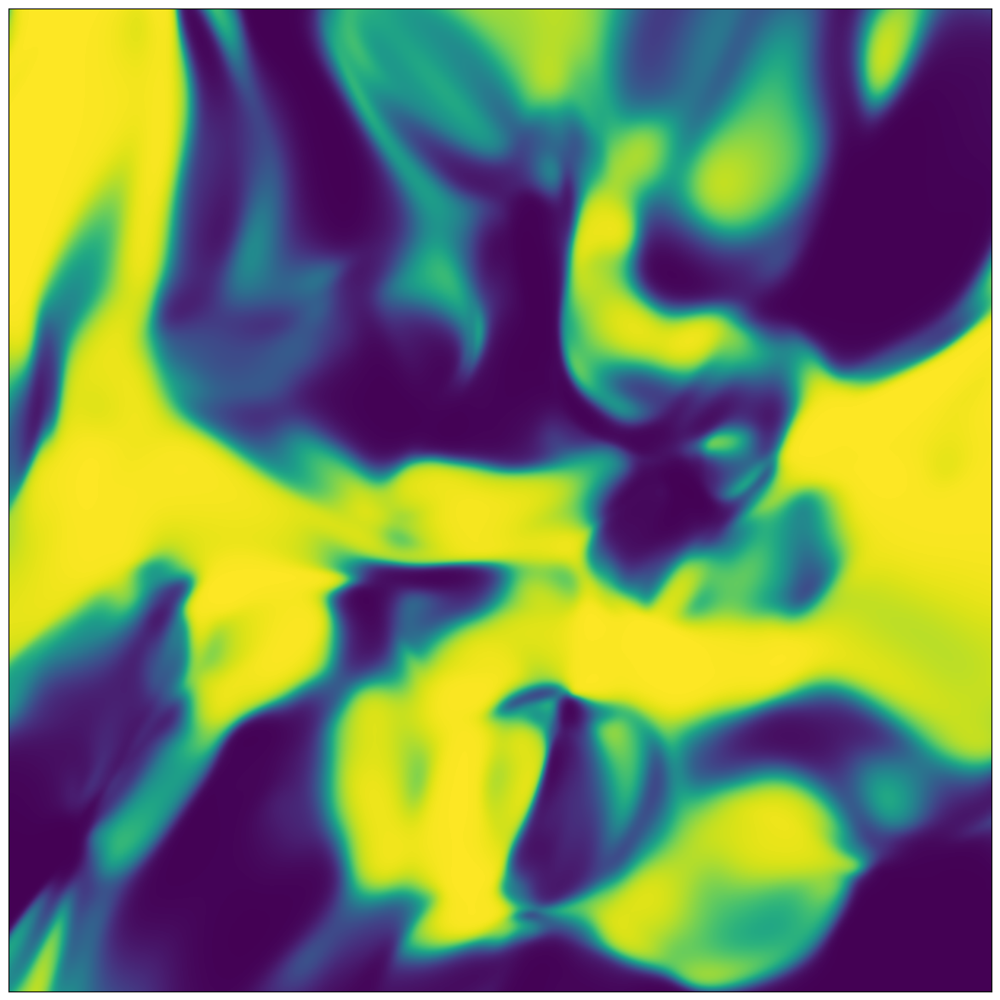

In [81]:
fig, axs = plt.subplots(1,1, figsize=(15,15))
axs.imshow(y.reshape(r,r), interpolation='bilinear',cmap='viridis')
axs.set_xticks([])
axs.set_yticks([])
plt.savefig('art2.png')

In [31]:
r = 1000
l = 0.5
x_range = (-l, l)
y_range = (-l, l)
resolution = (r, r)
x = create_2d_grid(x_range, y_range, resolution)

model = gray_scale_model(N_layers=60, N_neurons=20)

y = model.predict(x)

31250/31250 ━━━━━━━━━━━━━━━━━━━━ 53s 2ms/step


In [5]:
# Example usage
r = 500
l = 0.5
x_range = (-l, l)
y_range = (-l, l)
resolution = (r, r)

x = create_2d_grid(x_range, y_range, resolution)

In [10]:
model = rgb_model(N_layers=35, N_neurons=50)

In [11]:
images = []
dx = 0.001
for _ in range(500):
    ws = model.get_weights()
    for k in range(len(ws)):
        ws[k] = ws[k] + np.random.uniform(-dx, dx, ws[k].shape)
    model.set_weights(ws)
    y = model.predict(x)
    images.append(y.reshape(r,r,3))

7813/7813 ━━━━━━━━━━━━━━━━━━━━ 10s 1ms/step
7813/7813 ━━━━━━━━━━━━━━━━━━━━ 11s 1ms/step
7813/7813 ━━━━━━━━━━━━━━━━━━━━ 11s 1ms/step
7813/7813 ━━━━━━━━━━━━━━━━━━━━ 11s 1ms/step
7813/7813 ━━━━━━━━━━━━━━━━━━━━ 12s 2ms/step
7813/7813 ━━━━━━━━━━━━━━━━━━━━ 12s 2ms/step
7813/7813 ━━━━━━━━━━━━━━━━━━━━ 14s 2ms/step
7813/7813 ━━━━━━━━━━━━━━━━━━━━ 11s 1ms/step
7813/7813 ━━━━━━━━━━━━━━━━━━━━ 11s 1ms/step
7813/7813 ━━━━━━━━━━━━━━━━━━━━ 10s 1ms/step
7813/7813 ━━━━━━━━━━━━━━━━━━━━ 9s 1ms/step
7813/7813 ━━━━━━━━━━━━━━━━━━━━ 10s 1ms/step
7813/7813 ━━━━━━━━━━━━━━━━━━━━ 10s 1ms/step
7813/7813 ━━━━━━━━━━━━━━━━━━━━ 10s 1ms/step
7813/7813 ━━━━━━━━━━━━━━━━━━━━ 10s 1ms/step
7813/7813 ━━━━━━━━━━━━━━━━━━━━ 10s 1ms/step
7813/7813 ━━━━━━━━━━━━━━━━━━━━ 10s 1ms/step
7813/7813 ━━━━━━━━━━━━━━━━━━━━ 9s 1ms/step
7813/7813 ━━━━━━━━━━━━━━━━━━━━ 9s 1ms/step
7813/7813 ━━━━━━━━━━━━━━━━━━━━ 10s 1ms/step
7813/7813 ━━━━━━━━━━━━━━━━━━━━ 10s 1ms/step
7813/7813 ━━━━━━━━━━━━━━━━━━━━ 14s 2ms/step
7813/7813 ━━━━━━━━━━━━━━━━━━━━ 10s 

KeyboardInterrupt: 

In [12]:
# save images into files

for i, image in enumerate(images):

    img = (image - image.min()) / (image.max() - image.min())*225
    # img = np.uint32(img)
    img = np.uint8(img)
    # img = Image.fromarray(img[:,:,0])
    img = Image.fromarray(img, mode='HSV')
    img = img.convert('RGB')
    
    prefix = str(i)
    prefix_size = len(prefix)

    filename = "".join(["0" for j in range( 5 - prefix_size )] + [str(i)] )
    
    img.save(f"images_rgb/{filename}.png")   

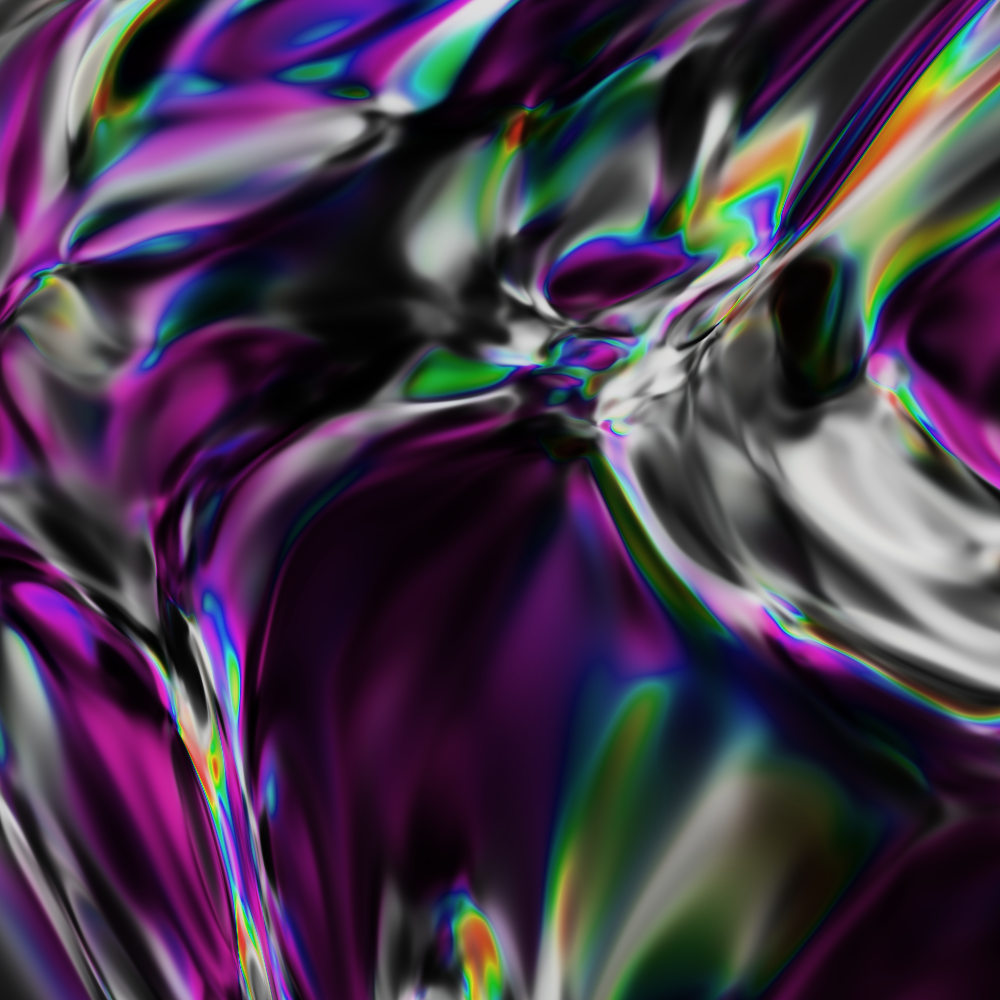

In [147]:
img